# Art Style Transfer using Cycle GAN

Style transfer algorithms in the context of art try to capture the general style of an artist or an image and apply it to one or many content pictures. This is essentially an unpaired image to image translation task.

## Introduction and set-up

Import all relevant packages and create paths.

In [1]:
# basic packages
import numpy as np
import pandas as pd
import scipy
import pickle
import random
import os

# loading in and transforming data
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torchvision.utils import make_grid
import PIL
from PIL import Image
import imageio

# visualizing data
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [2]:
# Paths et cetera
path_save_up_to_5gb = '/kaggle/working/'
path_monet = '../input/gan-getting-started/monet_jpg/'
path_photo = '../input/gan-getting-started/photo_jpg/'
img_size = 256

In [3]:
#running this will list all files under the input directory
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
for dirname, _, filenames in os.walk('/kaggle/working'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/gan-getting-started/monet_jpg/f4413e97bd.jpg
/kaggle/input/gan-getting-started/monet_jpg/7341d96c1d.jpg
/kaggle/input/gan-getting-started/monet_jpg/de6f71b00f.jpg
/kaggle/input/gan-getting-started/monet_jpg/99d94af5dd.jpg
/kaggle/input/gan-getting-started/monet_jpg/99a51d3e25.jpg
/kaggle/input/gan-getting-started/monet_jpg/d05cab011d.jpg
/kaggle/input/gan-getting-started/monet_jpg/4e05523825.jpg
/kaggle/input/gan-getting-started/monet_jpg/c68c52e8fc.jpg
/kaggle/input/gan-getting-started/monet_jpg/40d7d18ad3.jpg
/kaggle/input/gan-getting-started/monet_jpg/f96a8de9f3.jpg
/kaggle/input/gan-getting-started/monet_jpg/79224da51f.jpg
/kaggle/input/gan-getting-started/monet_jpg/23832dead5.jpg
/kaggle/input/gan-getting-started/monet_jpg/85580214be.jpg
/kaggle/input/gan-getting-started/monet_jpg/47a0548067.jpg
/kaggle/input/gan-getting-started/monet_jpg/fb93438ff9.jpg
/kaggle/input/gan-getting-started/monet_jpg/89d970411d.jpg
/kaggle/input/gan-getting-started/monet_jpg/7960adbd50.j

# Seed

Fixing the seed makes it easier to reproduce the results.

In [4]:
def set_seed(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True

In [5]:
set_seed(42)

# Save and load

In [6]:
def save_checkpoint(iteration, G_XtoY, G_YtoX, D_X, D_Y, checkpoint_dir='/kaggle/working/'):
    """
    Saves the parameters of both generators and discriminators.
    """
    #Path
    G_XtoY_path = os.path.join(checkpoint_dir, 'G_XtoY.pkl')
    G_YtoX_path = os.path.join(checkpoint_dir, 'G_YtoX.pkl')
    D_X_path = os.path.join(checkpoint_dir, 'D_X.pkl')
    D_Y_path = os.path.join(checkpoint_dir, 'D_Y.pkl')
    #Saving
    torch.save(G_XtoY.state_dict(), G_XtoY_path)
    torch.save(G_YtoX.state_dict(), G_YtoX_path)
    torch.save(D_X.state_dict(), D_X_path)
    torch.save(D_Y.state_dict(), D_Y_path)

In [7]:
def load_checkpoint(checkpoint_path, map_location=None):
    """
    Load checkoint
    """
    #model.load_state_dict(torch.load(checkpoint_path))
    checkpoint = torch.load(checkpoint_path, map_location=map_location)
    print(' [*] Loading checkpoint from %s succeed!' % checkpoint_path)
    return checkpoint

In [8]:
def show_test(fixed_Y, fixed_X, G_YtoX, G_XtoY, mean_=0.5, std_=0.5):
    """
    Shows results of generates based on test image input. 
    """
    #Identify correct device
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    #Create fake pictures for both cycles
    fake_X = G_YtoX(fixed_Y.to(device))
    fake_Y = G_XtoY(fixed_X.to(device))
    
    #Generate grids
    grid_x =  make_grid(fixed_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_y =  make_grid(fixed_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_fake_x =  make_grid(fake_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_fake_y =  make_grid(fake_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    
    #Normalize pictures to pixel range rom 0 to 255
    X, fake_X = reverse_normalize(grid_x, mean_, std_), reverse_normalize(grid_fake_x, mean_, std_)
    Y, fake_Y = reverse_normalize(grid_y, mean_, std_), reverse_normalize(grid_fake_y, mean_, std_)
    
    #Transformation from X -> Y
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(20, 10))
    ax1.imshow(X)
    ax1.axis('off')
    ax1.set_title('X')
    ax2.imshow(fake_Y)
    ax2.axis('off')
    ax2.set_title('Fake Y  (Monet-esque)')
    plt.show()

# Datasets & dataloaders

Pytorch has some powerful dataloaders that make working with data much easier. To use the dataloader one first needs to create a dataset. Pytorch has some good [tutorials](https://pytorch.org/tutorials/beginner/data_loading_tutorial.html) on how to get started with this. The transformation can be structured as a class of its own. However, in the below I decided to implement it directly in the Dataset.

In [9]:
 class ImageDataset(Dataset):
        """
        Custom dataset
        """
        
        def __init__(self, img_path, img_size=256, normalize=True):
            self.img_path = img_path
            
            if normalize:
                self.transform = transforms.Compose([
                    transforms.Resize(img_size),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.5], std=[0.5])
                ])
            else:
                self.transform = transforms.Compose([
                    transforms.Resize(img_size),
                    transforms.ToTensor()
                ])
            
            #Dictionary entries
            self.img_idx = dict()
            for number_, img_ in enumerate(os.listdir(self.img_path)):
                self.img_idx[number_] = img_
                
        def __len__(self):
            #Length of dataset --> number of images
            return len(self.img_idx)
        
        def __getitem__(self, idx):
            img_path = os.path.join(self.img_path, self.img_idx[idx])
            img = Image.open(img_path)
            img = self.transform(img)
            
            return img

In [10]:
def reverse_normalize(image, mean_=0.5, std_=0.5):
    if torch.is_tensor(image):
        image = image.detach().numpy()
    un_normalized_img = image * std_ + mean_
    un_normalized_img = un_normalized_img * 255
    return np.uint8(un_normalized_img)

In [11]:
#Create datasets
dataset_monet = ImageDataset(path_monet, img_size=256, normalize=True) #monet
dataset_photo = ImageDataset(path_photo, img_size=256, normalize=True) #photo

In [12]:
#Create test loaders
batch_size_test = 8
batch_size=16
test_dataloader_Y = DataLoader(dataset_monet, batch_size=batch_size_test, shuffle=False, num_workers=0, pin_memory=True)
test_dataloader_X = DataLoader(dataset_photo, batch_size=batch_size_test, shuffle=False, num_workers=0, pin_memory=True)
dataloader_Y = DataLoader(dataset_monet, batch_size=batch_size, shuffle=True, num_workers=0, pin_memory=True)
dataloader_X = DataLoader(dataset_photo, batch_size=batch_size, shuffle=True, num_workers=0, pin_memory=True)

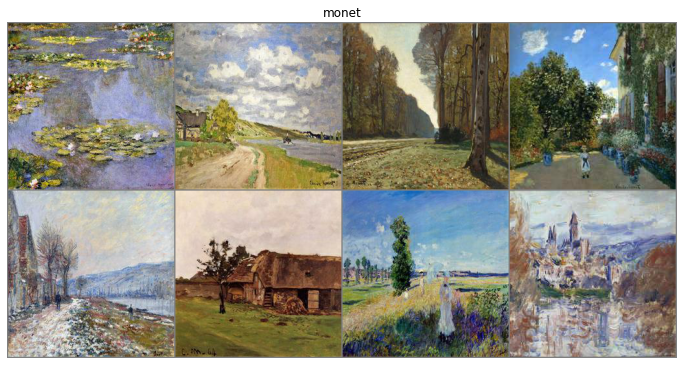

In [13]:
#Check dataset & dataloader results
dataiter = iter(test_dataloader_Y)
images_normalized = dataiter.next()
grid_normalized = make_grid(images_normalized, nrow=4).permute(1, 2, 0).detach().numpy()
grid_original = reverse_normalize(grid_normalized)
fig = plt.figure(figsize=(12, 8))
plt.imshow(grid_original)
plt.axis('off')
plt.title('monet')
plt.show()

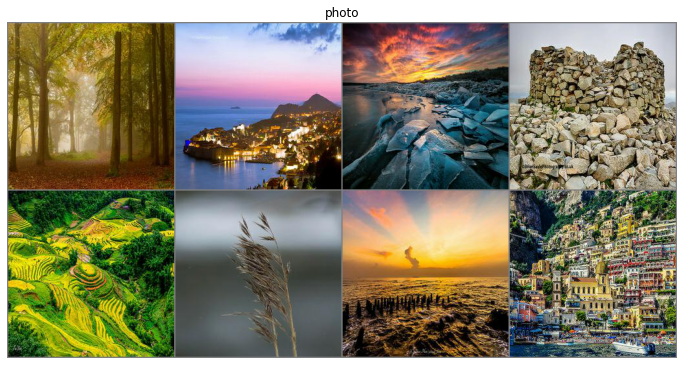

In [14]:
#Check dataset & dataloader results
dataiter = iter(test_dataloader_X)
images_normalized = dataiter.next()
grid_normalized = make_grid(images_normalized, nrow=4).permute(1, 2, 0).detach().numpy()
grid_original = reverse_normalize(grid_normalized)
fig = plt.figure(figsize=(12, 8))
plt.imshow(grid_original)
plt.axis('off')
plt.title('photo')
plt.show()

# Model

## Discriminator
The adversarial discriminators $D_X$ and $D_Y$ in our model are CNNs that see an image and try to classify it as real of fake. Real images are classified with an output close to 1 while fake classifications have an output close to 0. $D_Y$ encourages and classifies the transformation from domain X to Y (making photos into monet pictures). $D_X$ represents transformation classification from domain Y to X. 

We start out by creating a helper function that creates a convolutional layer, with optional batch or instance normalization. 
__Batch normalization__ was initially believed to improve deep learning models by reducing the "internal covariate shift" as proposed by [Ioffe and Szegedy (2015)](https://arxiv.org/pdf/1502.03167.pdf%20http://arxiv.org/abs/1502.03167.pdf). However, other papers such as by [Santurkar et al (2019)](https://arxiv.org/pdf/1805.11604.pdf) claim that the main advantage of using batch normalization is an improvement in the smoothness of the optimization landscape. 
__Instance normalization__ is a similar method that seems to work particularly well for style transfer, which is why we will use it in the below implementation. More information can be found in [Ulyanov and Vedaldi (2017)](https://arxiv.org/pdf/1607.08022.pdf).

In [15]:
import torch.nn as nn
import torch.nn.functional as F

def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=False, instance_norm=False):
    """
    Creates a convolutional layer, with optional batch / instance normalization. 
    """
    
    #Add layers
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
    layers.append(conv_layer)
    
    #Batch normalization
    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    
    #Instance normalization
    if instance_norm:
        layers.append(nn.InstanceNorm2d(out_channels))
    return nn.Sequential(*layers)

Next we construct the discriminator class. We will use the "raw" output as we will use a mean squared error loss. 

In [16]:
class Discriminator(nn.Module):
    
    def __init__(self, conv_dim=64):
        super(Discriminator, self).__init__()
        """
        Input is RGB image (256x256x3) while output is a single value
        
        determine size = [(W−K+2P)/S]+1
        W: input=256
        K: kernel_size=4
        P: padding=1
        S: stride=2
        """
        
        #convolutional layers, increasing in depth
        self.conv1 = conv(in_channels=3, out_channels=conv_dim, kernel_size=4) # (128, 128, 64)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.conv3 = conv(in_channels=conv_dim*2, out_channels=conv_dim*4, kernel_size=4, instance_norm=True) # (32, 32, 256)
        self.conv4 = conv(in_channels=conv_dim*4, out_channels=conv_dim*8, kernel_size=4, instance_norm=True) # (16, 16, 512)
        self.conv5 = conv(in_channels=conv_dim*8, out_channels=conv_dim*8, kernel_size=4, batch_norm=True) # (8, 8, 512)
        
        #final classification layer
        self.conv6 = conv(conv_dim*8, out_channels=1, kernel_size=4, stride=1) # (8, 8, 1)
    
    def forward(self, x):
        
        #leaky relu applied to all conv layers but last
        out = F.leaky_relu(self.conv1(x), negative_slope=0.2)
        out = F.leaky_relu(self.conv2(out), negative_slope=0.2)
        out = F.leaky_relu(self.conv3(out), negative_slope=0.2)
        out = F.leaky_relu(self.conv4(out), negative_slope=0.2)
#         out = F.leaky_relu(self.conv5(out), negative_slope=0.2)
        
        #classification layer (--> depending on the loss function we might want to use an activation function here, e.g. sigmoid)
        out = self.conv6(out)
        return out

## Generator
We have two generators (G_XtoY and G_YtoX). They each consist of 
* encoder (compressing the image into a smaller feature representation), 
* residual blocks (connecting the output of one layer with the input of an earlier layer) and 
* decoder (turning compressed representation into a transformed image). <br>

If you want to know more about the residual blocks have a look at [He et al. (2015)](https://arxiv.org/pdf/1512.03385.pdf). Here we only design 1 residual block. The generator will have a parameter that allows to repeat this component multiple times.

In [17]:
class ResidualBlock(nn.Module):

    def __init__(self, conv_dim):
        super(ResidualBlock, self).__init__()
        """
        Residual blocks help the model to effectively learn the transformation from one domain to another. 
        """
        self.conv1 = conv(in_channels=conv_dim, out_channels=conv_dim, kernel_size=3, stride=1, padding=1, instance_norm=True)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim, kernel_size=3, stride=1, padding=1, instance_norm=True)
        
    def forward(self, x):
        out_1 = F.relu(self.conv1(x))
        out_2 = x + self.conv2(out_1)
        return out_2

In [18]:
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=False, instance_norm=False, dropout=False, dropout_ratio=0.5):
    """
    Creates a transpose convolutional layer, with optional batch / instance normalization. Select either batch OR instance normalization. 
    """
    
    #Add layers
    layers = []
    layers.append(nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False))
    
    #Batch normalization
    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    
    #Instance normalization
    if instance_norm:
        layers.append(nn.InstanceNorm2d(out_channels))
    
    #Dropout
    if dropout:
        layers.append(nn.Dropout2d(dropout_ratio))
    
    return nn.Sequential(*layers)

In [19]:
class CycleGenerator(nn.Module):
    
    def __init__(self, conv_dim=64, n_res_blocks=6):
        super(CycleGenerator, self).__init__()
        """
        Input is RGB image (256x256x3) while output is a single value
        
        determine size = [(W−K+2P)/S]+1
        W: input=256
        K: kernel_size=4
        P: padding=1
        S: stride=2
        """
        
        #Encoder layers
        self.conv1 = conv(in_channels=3, out_channels=conv_dim, kernel_size=4) # (128, 128, 64)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.conv3 = conv(in_channels=conv_dim*2, out_channels=conv_dim*4, kernel_size=4, instance_norm=True) # (32, 32, 256)
        
        #Residual blocks (number depends on input parameter)
        res_layers = []
        for layer in range(n_res_blocks):
            res_layers.append(ResidualBlock(conv_dim*4))
        self.res_blocks = nn.Sequential(*res_layers)
        
        #Decoder layers
        self.deconv4 = deconv(in_channels=conv_dim*4, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.deconv5 = deconv(in_channels=conv_dim*2, out_channels=conv_dim, kernel_size=4, instance_norm=True) # (128, 128, 64)
        self.deconv6 = deconv(in_channels=conv_dim, out_channels=3, kernel_size=4, instance_norm=True) # (256, 256, 3)
        
    def forward(self, x):
        """
        Given an image x, returns a transformed image.
        """
        
        #Encoder
        out = F.leaky_relu(self.conv1(x), negative_slope=0.2) # (128, 128, 64)
        out = F.leaky_relu(self.conv2(out), negative_slope=0.2) # (64, 64, 128)
        out = F.leaky_relu(self.conv3(out), negative_slope=0.2) # (32, 32, 256)
        
        #Residual blocks
        out = self.res_blocks(out)
        
        #Decoder
        out = F.leaky_relu(self.deconv4(out), negative_slope=0.2) # (64, 64, 128)
        out = F.leaky_relu(self.deconv5(out), negative_slope=0.2) # (128, 128, 64)
        out = torch.tanh(self.deconv6(out)) # (256, 256, 3)
        
        return out

In [20]:
from torch.nn import init
def weights_init_normal(m):
    """
    Applies initial weights to certain layers in a model.
    The weights are taken from a normal distribution with mean = 0, std dev = 0.02.
    Param m: A module or layer in a network    
    """
    #classname will be something like: `Conv`, `BatchNorm2d`, `Linear`, etc.
    classname = m.__class__.__name__
    
    #normal distribution with given paramters
    std_dev = 0.02
    mean = 0.0
    
    # Initialize conv layer
    if hasattr(m, 'weight') and (classname.find('Conv') != -1):
        init.normal_(m.weight.data, mean, std_dev)

In [21]:
def build_model(g_conv_dim=64, d_conv_dim=64, n_res_blocks=6):
    """
    Builds generators G_XtoY & G_YtoX and discriminators D_X & D_Y 
    """
    
    #Generators
    G_XtoY = CycleGenerator(conv_dim=g_conv_dim, n_res_blocks=n_res_blocks)
    G_YtoX = CycleGenerator(conv_dim=g_conv_dim, n_res_blocks=n_res_blocks)
    
    #Discriminators
    D_X = Discriminator(conv_dim=d_conv_dim) # Y-->X
    D_Y = Discriminator(conv_dim=d_conv_dim) # X-->Y
    
    #Weight initialization
    G_XtoY.apply(weights_init_normal)
    G_YtoX.apply(weights_init_normal)
    D_X.apply(weights_init_normal)
    D_Y.apply(weights_init_normal)
    
    #Moves models to GPU, if available
    if torch.cuda.is_available():
        device = torch.device("cuda:0")
        G_XtoY.to(device)
        G_YtoX.to(device)
        D_X.to(device)
        D_Y.to(device)
        print('Models moved to GPU.')
    else:
        print('Only CPU available.')

    return G_XtoY, G_YtoX, D_X, D_Y

In [22]:
#Function call
G_XtoY, G_YtoX, D_X, D_Y = build_model()

Models moved to GPU.


In [23]:
#Check model structure
def print_build(G_XtoY, G_YtoX, D_X, D_Y):
    print("                     G_XtoY                    ")
    print("-----------------------------------------------")
    print(G_XtoY)
    print()

    print("                     G_YtoX                    ")
    print("-----------------------------------------------")
    print(G_YtoX)
    print()

    print("                      D_X                      ")
    print("-----------------------------------------------")
    print(D_X)
    print()

    print("                      D_Y                      ")
    print("-----------------------------------------------")
    print(D_Y)
    print()
    
print_build(G_XtoY, G_YtoX, D_X, D_Y)

                     G_XtoY                    
-----------------------------------------------
CycleGenerator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (res_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      )
      (conv2): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3)

## Loss function

### Adversarial loss
As mentioned earlier we have two discriminator losses. The loss for both functions will be the mean squared error between the output of the respective discriminator and the target value (either 1 or 0). In the code this is implemented via real_mse_loss and fake_mse_loss. 

### Cycle consistency loss
Forward cycle-consistency loss from X->Y->X. Backward cycle-consistency loss from Y->X->Y. 

### Identity loss
Forward identity loss X->Y. Backward identity loss from Y->X.

In [24]:
def real_mse_loss(D_out, adverserial_weight=1):
    #how close is the produced output from being "real"?
    mse_loss = torch.mean((D_out-1)**2)*adverserial_weight
    return mse_loss

def fake_mse_loss(D_out, adverserial_weight=1):
    #how close is the produced output from being "false"?
    mse_loss = torch.mean(D_out**2)*adverserial_weight
    return mse_loss

def cycle_consistency_loss(real_img, reconstructed_img, lambda_weight=1):
    reconstr_loss = torch.mean(torch.abs(real_img - reconstructed_img))
    return lambda_weight*reconstr_loss 

def identity_loss(real_img, generated_img, identity_weight=1):
    ident_loss = torch.mean(torch.abs(real_img - generated_img))
    return identity_weight*ident_loss

# Optimizers

In [25]:
import torch.optim as optim

#hyperparameter
lr=0.0002 #0.0002
beta1=0.500 #exponential decay rate for the first moment estimates
beta2=0.999 #exponential decay rate for the second-moment estimates
g_params = list(G_XtoY.parameters()) + list(G_YtoX.parameters())

#Optimizers for generator and discriminator
g_optimizer = optim.Adam(g_params, lr, [beta1, beta2])
d_x_optimizer = optim.Adam(D_X.parameters(), lr, [beta1, beta2])
d_y_optimizer = optim.Adam(D_Y.parameters(), lr, [beta1, beta2])

# Training

In [26]:
def training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y, n_epochs=1000):
    
    #Losses over time
    losses = []
    
    #Additional weighting parameters (in reality only 2 are required as the third is kind of "given relatively" by the other two)
    adverserial_weight = 0.5
    lambda_weight = 10
    identity_weight = 5
    
    #Get some fixed data from domains X and Y for sampling. Images are held constant throughout training and allow us to inspect the model's performance.
    test_iter_X = iter(test_dataloader_X)
    test_iter_Y = iter(test_dataloader_Y)
    fixed_X = test_iter_X.next()
    fixed_Y = test_iter_Y.next()
    
    # batches per epoch
    iter_X = iter(dataloader_X)
    iter_Y = iter(dataloader_Y)
    batches_per_epoch = min(len(iter_X), len(iter_Y))
    
    #Average loss over batches per epoch runs
    d_total_loss_avg = 0.0
    g_total_loss_avg = 0.0
    
    #Loop through epochs
    for epoch in range(1, n_epochs+1):
        
        #reset iterators for each epoch
        if epoch % batches_per_epoch == 0:
            iter_X = iter(dataloader_X)
            iter_Y = iter(dataloader_Y)
        
        #Get images from domain X
        images_X = iter_X.next()
        
        #Get images from domain Y
        images_Y = iter_Y.next()
        
        #move images to GPU if available (otherwise stay on CPU)
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        images_X = images_X.to(device)
        images_Y = images_Y.to(device)
        
        
        # ============================================
        #            TRAIN THE DISCRIMINATORS
        # ============================================
        
        
        # --------------------------------------------
        ## First: D_X, real and fake loss components
        # --------------------------------------------
        
        # Train with real images
        d_x_optimizer.zero_grad()
        
        # 1. Compute the discriminator losses on real images
        out_x = D_X(images_X)
        D_X_real_loss = real_mse_loss(out_x, adverserial_weight)
        
        # Train with fake images
        # 2. Generate fake images that look like domain X based on real images in domain Y
        fake_X = G_YtoX(images_Y)

        # 3. Compute the fake loss for D_X
        out_x = D_X(fake_X)
        D_X_fake_loss = fake_mse_loss(out_x, adverserial_weight)
        
        # 4. Compute the total loss and perform backpropagation
        d_x_loss = D_X_real_loss + D_X_fake_loss
        d_x_loss.backward()
        d_x_optimizer.step()
        
        # --------------------------------------------
        ## Second: D_Y, real and fake loss components
        # --------------------------------------------
        
        # Train with real images
        d_y_optimizer.zero_grad()
        
        # 1. Compute the discriminator losses on real images
        out_y = D_Y(images_Y)
        D_Y_real_loss = real_mse_loss(out_y, adverserial_weight)
        
        # Train with fake images
        # 2. Generate fake images that look like domain Y based on real images in domain X
        fake_Y = G_XtoY(images_X)
        
        # 3. Compute the fake loss for D_Y
        out_y = D_Y(fake_Y)
        D_Y_fake_loss = fake_mse_loss(out_y, adverserial_weight)
        
        # 4. Compute the total loss and perform backprop
        d_y_loss = D_Y_real_loss + D_Y_fake_loss
        d_y_loss.backward()
        d_y_optimizer.step()
        
        # 5. Compute total discriminator loss
        d_total_loss = D_X_real_loss + D_X_fake_loss + D_Y_real_loss + D_Y_fake_loss
        

        # =========================================
        #            TRAIN THE GENERATORS
        # =========================================
        
        
        # --------------------------------------------
        ## First: generate fake X images and reconstructed Y images
        # --------------------------------------------
        
        #Back to the start
        g_optimizer.zero_grad()
        
        # 1. Generate fake images that look like domain X based on real images in domain Y
        fake_X = G_YtoX(images_Y)
        
        # 2. Compute the generator loss based on domain X
        out_x = D_X(fake_X)
        g_YtoX_loss = real_mse_loss(out_x, adverserial_weight)

        # 3. Create a reconstructed y
        reconstructed_Y = G_XtoY(fake_X)
        
        # 4. Compute the cycle consistency loss (the reconstruction loss)
        reconstructed_y_loss = cycle_consistency_loss(images_Y, reconstructed_Y, lambda_weight=lambda_weight)
        
        # 5. Compute the identity loss from transformation Y-->X
        identity_y_loss = identity_loss(images_Y, fake_X, identity_weight=identity_weight)
        
        # --------------------------------------------
        ## Second: generate fake Y images and reconstructed X images
        # --------------------------------------------
        
        # 1. Generate fake images that look like domain Y based on real images in domain X
        fake_Y = G_XtoY(images_X)
        
        # 2. Compute the generator loss based on domain Y
        out_y = D_Y(fake_Y) #if discriminator believes picture to be from domain Y it returns values cloer to 1, else closer to 0
        g_XtoY_loss = real_mse_loss(out_y, adverserial_weight)
        
        # 3. Create a reconstructed x
        reconstructed_X = G_YtoX(fake_Y)
        
        # 4. Compute the cycle consistency loss (the reconstruction loss)
        reconstructed_x_loss = cycle_consistency_loss(images_X, reconstructed_X, lambda_weight=lambda_weight)
        
        # 5. Compute the identity loss from transformation X-->Y
        identity_x_loss = identity_loss(images_X, fake_Y, identity_weight=identity_weight)
        
        # 6. Add up all generator and reconstructed losses and perform backprop
        g_total_loss = g_YtoX_loss + g_XtoY_loss + reconstructed_y_loss + reconstructed_x_loss + identity_y_loss + identity_x_loss
        g_total_loss.backward()
        g_optimizer.step()
        
        
        # =========================================
        # Admin 
        # =========================================
        
        
        #Average loss
        d_total_loss_avg = d_total_loss_avg + d_total_loss / batches_per_epoch
        g_total_loss_avg = g_total_loss_avg + g_total_loss / batches_per_epoch
        
        # Print log info
        print_every = batches_per_epoch
        if epoch % print_every == 0:
            # append real and fake discriminator losses and the generator loss
            losses.append((d_total_loss_avg.item(), g_total_loss_avg.item()))
            true_epoch_n = int(epoch/batches_per_epoch)
            true_epoch_total = int(n_epochs/batches_per_epoch)
            print('Epoch [{:5d}/{:5d}] | d_total_loss_avg: {:6.4f} | g_total_loss: {:6.4f}'.format(
                    true_epoch_n, true_epoch_total, d_total_loss_avg.item(), g_total_loss_avg.item()))
        
        #Show the generated samples
        show_every = (batches_per_epoch*10)
        if epoch % show_every == 0:
            #set generators to eval mode for image generation
            G_YtoX.eval()
            G_XtoY.eval()
            test_images = show_test(fixed_Y, fixed_X, G_YtoX, G_XtoY)
            #set generators to train mode to continue training
            G_YtoX.train()
            G_XtoY.train()
        
#         #save the model parameters
#         checkpoint_every=3000
#         if epoch % checkpoint_every == 0:
#             save_checkpoint(epoch, G_XtoY, G_YtoX, D_X, D_Y)
    
        #reset average loss for each epoch
        if epoch % batches_per_epoch == 0:
            d_total_loss_avg = 0.0
            g_total_loss_avg = 0.0
    
    return losses

Due to the implementation of the loop there is no "real" differenciation between epoch and batch. We calculate it below.

In [27]:
batches_per_epoch = min(len(dataloader_X), len(dataloader_Y))
epoch_true = 256

Epoch [    1/  256] | d_total_loss_avg: 4.0580 | g_total_loss: 17.8191
Epoch [    2/  256] | d_total_loss_avg: 1.1713 | g_total_loss: 11.7839
Epoch [    3/  256] | d_total_loss_avg: 0.7111 | g_total_loss: 10.4031
Epoch [    4/  256] | d_total_loss_avg: 0.6023 | g_total_loss: 9.8130
Epoch [    5/  256] | d_total_loss_avg: 0.5856 | g_total_loss: 9.5125
Epoch [    6/  256] | d_total_loss_avg: 0.5152 | g_total_loss: 9.0961
Epoch [    7/  256] | d_total_loss_avg: 0.5046 | g_total_loss: 9.0455
Epoch [    8/  256] | d_total_loss_avg: 0.4431 | g_total_loss: 8.6288
Epoch [    9/  256] | d_total_loss_avg: 0.3858 | g_total_loss: 8.4462
Epoch [   10/  256] | d_total_loss_avg: 0.6366 | g_total_loss: 8.4095


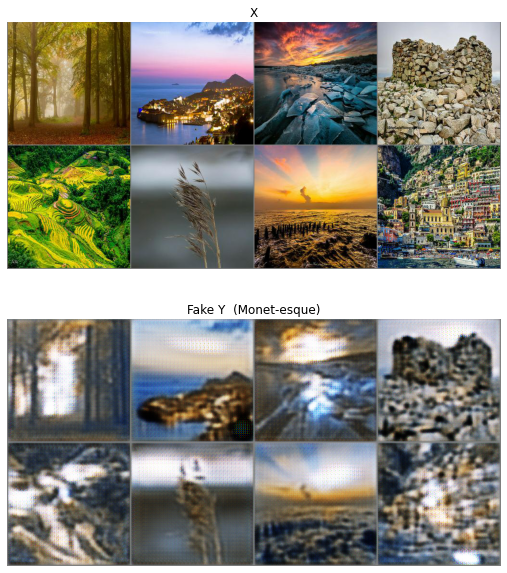

Epoch [   11/  256] | d_total_loss_avg: 0.3639 | g_total_loss: 8.4093
Epoch [   12/  256] | d_total_loss_avg: 0.3527 | g_total_loss: 8.0199
Epoch [   13/  256] | d_total_loss_avg: 0.3822 | g_total_loss: 8.1794
Epoch [   14/  256] | d_total_loss_avg: 0.4206 | g_total_loss: 8.0195
Epoch [   15/  256] | d_total_loss_avg: 0.3475 | g_total_loss: 7.9322
Epoch [   16/  256] | d_total_loss_avg: 0.3279 | g_total_loss: 7.9706
Epoch [   17/  256] | d_total_loss_avg: 0.3772 | g_total_loss: 7.8795
Epoch [   18/  256] | d_total_loss_avg: 0.3862 | g_total_loss: 7.9525
Epoch [   19/  256] | d_total_loss_avg: 0.3534 | g_total_loss: 7.8064
Epoch [   20/  256] | d_total_loss_avg: 0.3148 | g_total_loss: 7.6813


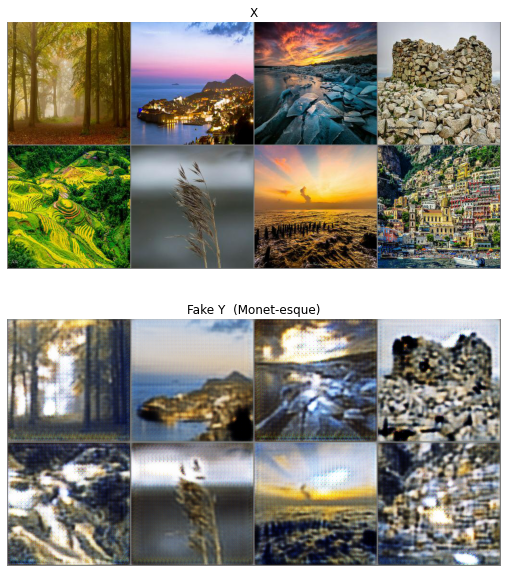

Epoch [   21/  256] | d_total_loss_avg: 0.3323 | g_total_loss: 7.9249
Epoch [   22/  256] | d_total_loss_avg: 0.3985 | g_total_loss: 7.5528
Epoch [   23/  256] | d_total_loss_avg: 0.3206 | g_total_loss: 7.6042
Epoch [   24/  256] | d_total_loss_avg: 0.3247 | g_total_loss: 7.6012
Epoch [   25/  256] | d_total_loss_avg: 0.2657 | g_total_loss: 7.8035
Epoch [   26/  256] | d_total_loss_avg: 0.3930 | g_total_loss: 7.6783
Epoch [   27/  256] | d_total_loss_avg: 0.2870 | g_total_loss: 7.6187
Epoch [   28/  256] | d_total_loss_avg: 0.3589 | g_total_loss: 7.5256
Epoch [   29/  256] | d_total_loss_avg: 0.3423 | g_total_loss: 7.6553
Epoch [   30/  256] | d_total_loss_avg: 0.2500 | g_total_loss: 7.6497


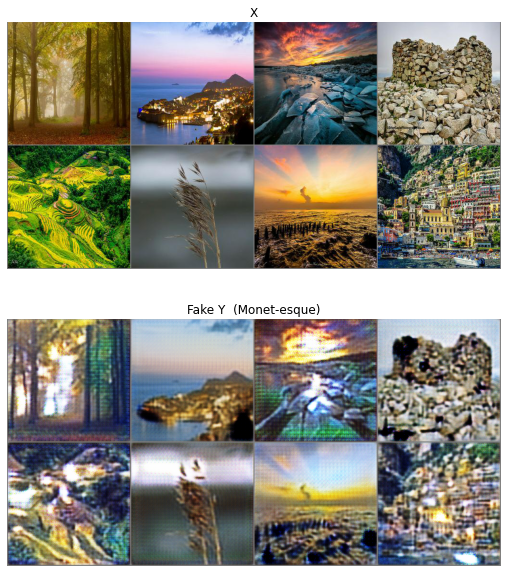

Epoch [   31/  256] | d_total_loss_avg: 0.2850 | g_total_loss: 7.4367
Epoch [   32/  256] | d_total_loss_avg: 0.3167 | g_total_loss: 7.3475
Epoch [   33/  256] | d_total_loss_avg: 0.2943 | g_total_loss: 7.4473
Epoch [   34/  256] | d_total_loss_avg: 0.3138 | g_total_loss: 7.4618
Epoch [   35/  256] | d_total_loss_avg: 0.2566 | g_total_loss: 7.5169
Epoch [   36/  256] | d_total_loss_avg: 0.2953 | g_total_loss: 7.4298
Epoch [   37/  256] | d_total_loss_avg: 0.3010 | g_total_loss: 7.3915
Epoch [   38/  256] | d_total_loss_avg: 0.2703 | g_total_loss: 7.4670
Epoch [   39/  256] | d_total_loss_avg: 0.2450 | g_total_loss: 7.3449
Epoch [   40/  256] | d_total_loss_avg: 0.3356 | g_total_loss: 7.0620


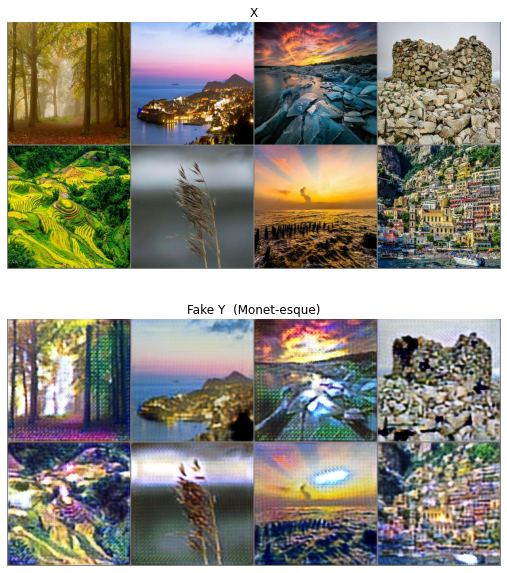

Epoch [   41/  256] | d_total_loss_avg: 0.2464 | g_total_loss: 7.3619
Epoch [   42/  256] | d_total_loss_avg: 0.3020 | g_total_loss: 7.4170
Epoch [   43/  256] | d_total_loss_avg: 0.3013 | g_total_loss: 7.4042
Epoch [   44/  256] | d_total_loss_avg: 0.2446 | g_total_loss: 7.4941
Epoch [   45/  256] | d_total_loss_avg: 0.2880 | g_total_loss: 7.3535
Epoch [   46/  256] | d_total_loss_avg: 0.2690 | g_total_loss: 7.4779
Epoch [   47/  256] | d_total_loss_avg: 0.2558 | g_total_loss: 7.3345
Epoch [   48/  256] | d_total_loss_avg: 0.2447 | g_total_loss: 7.6953
Epoch [   49/  256] | d_total_loss_avg: 0.2696 | g_total_loss: 7.4662
Epoch [   50/  256] | d_total_loss_avg: 0.3067 | g_total_loss: 7.1869


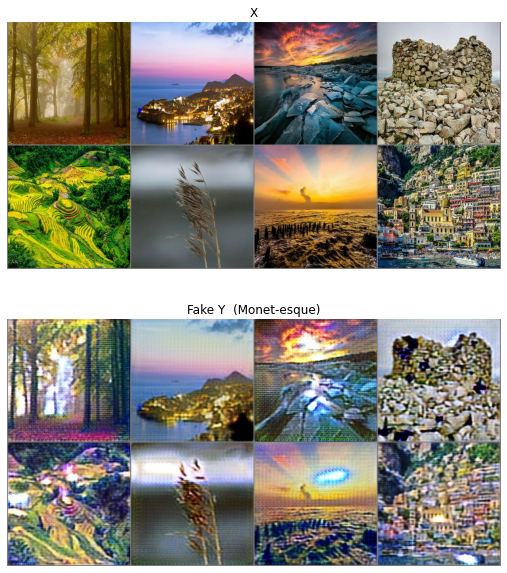

Epoch [   51/  256] | d_total_loss_avg: 0.2481 | g_total_loss: 7.2644
Epoch [   52/  256] | d_total_loss_avg: 0.2130 | g_total_loss: 7.3630
Epoch [   53/  256] | d_total_loss_avg: 0.3371 | g_total_loss: 7.3379
Epoch [   54/  256] | d_total_loss_avg: 0.2681 | g_total_loss: 7.4383
Epoch [   55/  256] | d_total_loss_avg: 0.2037 | g_total_loss: 7.3911
Epoch [   56/  256] | d_total_loss_avg: 0.2563 | g_total_loss: 7.2106
Epoch [   57/  256] | d_total_loss_avg: 0.2579 | g_total_loss: 7.1324
Epoch [   58/  256] | d_total_loss_avg: 0.2154 | g_total_loss: 7.2506
Epoch [   59/  256] | d_total_loss_avg: 0.2999 | g_total_loss: 7.1374
Epoch [   60/  256] | d_total_loss_avg: 0.2406 | g_total_loss: 7.3603


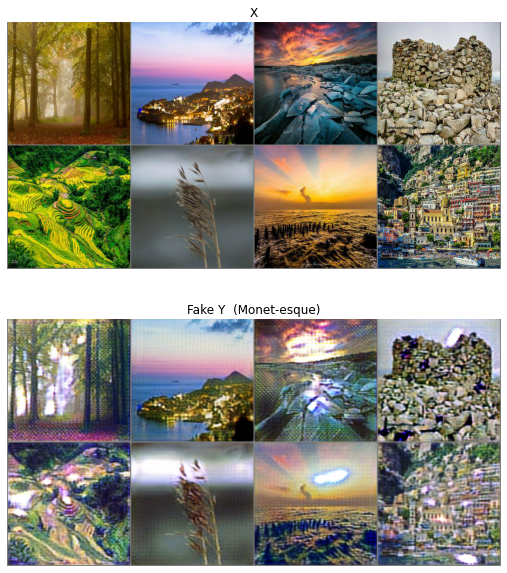

Epoch [   61/  256] | d_total_loss_avg: 0.2250 | g_total_loss: 7.1151
Epoch [   62/  256] | d_total_loss_avg: 0.2868 | g_total_loss: 7.3598
Epoch [   63/  256] | d_total_loss_avg: 0.2247 | g_total_loss: 7.0921
Epoch [   64/  256] | d_total_loss_avg: 0.2515 | g_total_loss: 7.2276
Epoch [   65/  256] | d_total_loss_avg: 0.2692 | g_total_loss: 7.1447
Epoch [   66/  256] | d_total_loss_avg: 0.2081 | g_total_loss: 7.1737
Epoch [   67/  256] | d_total_loss_avg: 0.3251 | g_total_loss: 7.2327
Epoch [   68/  256] | d_total_loss_avg: 0.2204 | g_total_loss: 7.3577
Epoch [   69/  256] | d_total_loss_avg: 0.2294 | g_total_loss: 7.1440
Epoch [   70/  256] | d_total_loss_avg: 0.2106 | g_total_loss: 7.1574


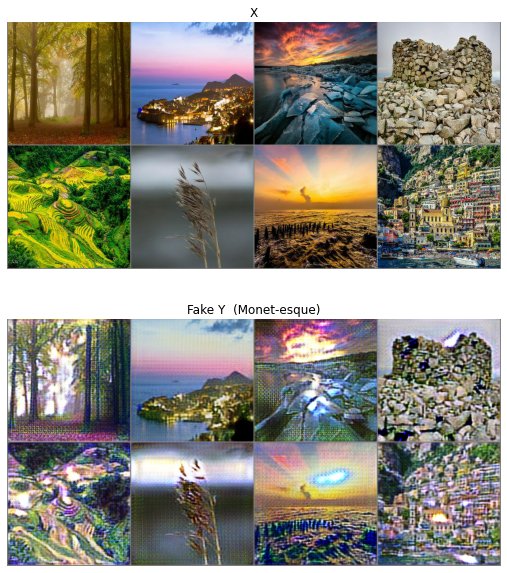

Epoch [   71/  256] | d_total_loss_avg: 0.2129 | g_total_loss: 6.8545
Epoch [   72/  256] | d_total_loss_avg: 0.2719 | g_total_loss: 7.1607
Epoch [   73/  256] | d_total_loss_avg: 0.2120 | g_total_loss: 6.9843
Epoch [   74/  256] | d_total_loss_avg: 0.2159 | g_total_loss: 7.1322
Epoch [   75/  256] | d_total_loss_avg: 0.3015 | g_total_loss: 7.1439
Epoch [   76/  256] | d_total_loss_avg: 0.2891 | g_total_loss: 6.9185
Epoch [   77/  256] | d_total_loss_avg: 0.1847 | g_total_loss: 6.8510
Epoch [   78/  256] | d_total_loss_avg: 0.2094 | g_total_loss: 7.1798
Epoch [   79/  256] | d_total_loss_avg: 0.2274 | g_total_loss: 6.9318
Epoch [   80/  256] | d_total_loss_avg: 0.1989 | g_total_loss: 7.0334


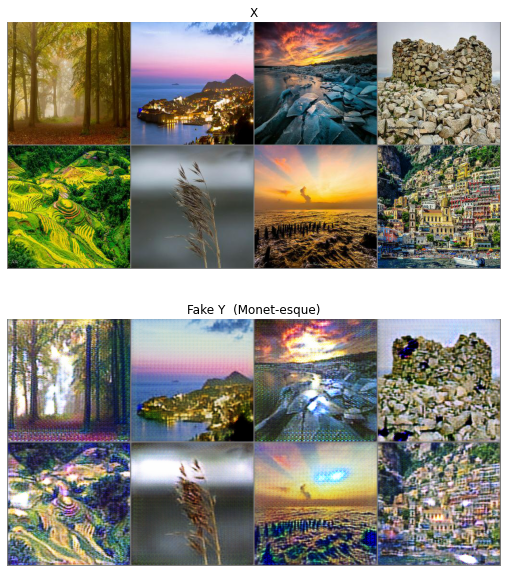

Epoch [   81/  256] | d_total_loss_avg: 0.2552 | g_total_loss: 7.2286
Epoch [   82/  256] | d_total_loss_avg: 0.2125 | g_total_loss: 7.0564
Epoch [   83/  256] | d_total_loss_avg: 0.2566 | g_total_loss: 6.9446
Epoch [   84/  256] | d_total_loss_avg: 0.1914 | g_total_loss: 6.8732
Epoch [   85/  256] | d_total_loss_avg: 0.2375 | g_total_loss: 6.7781
Epoch [   86/  256] | d_total_loss_avg: 0.2212 | g_total_loss: 6.9161
Epoch [   87/  256] | d_total_loss_avg: 0.2135 | g_total_loss: 6.8725
Epoch [   88/  256] | d_total_loss_avg: 0.2417 | g_total_loss: 7.0719
Epoch [   89/  256] | d_total_loss_avg: 0.1755 | g_total_loss: 6.9629
Epoch [   90/  256] | d_total_loss_avg: 0.2231 | g_total_loss: 7.0048


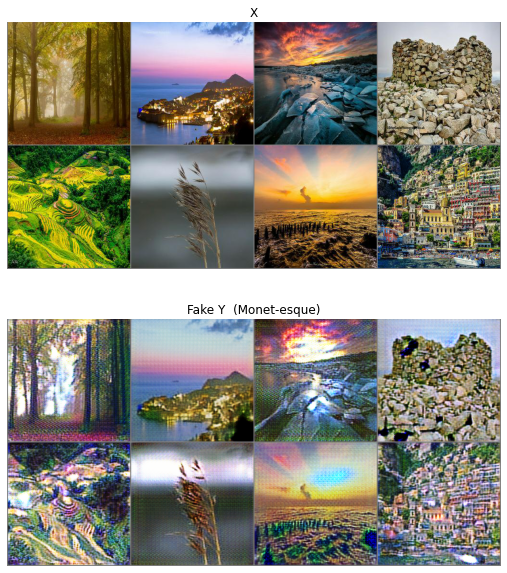

Epoch [   91/  256] | d_total_loss_avg: 0.2091 | g_total_loss: 7.1032
Epoch [   92/  256] | d_total_loss_avg: 0.2429 | g_total_loss: 7.0556
Epoch [   93/  256] | d_total_loss_avg: 0.1624 | g_total_loss: 6.9046
Epoch [   94/  256] | d_total_loss_avg: 0.2104 | g_total_loss: 6.8567
Epoch [   95/  256] | d_total_loss_avg: 0.2030 | g_total_loss: 6.9723
Epoch [   96/  256] | d_total_loss_avg: 0.2252 | g_total_loss: 6.7347
Epoch [   97/  256] | d_total_loss_avg: 0.2121 | g_total_loss: 6.9709
Epoch [   98/  256] | d_total_loss_avg: 0.2011 | g_total_loss: 7.0277
Epoch [   99/  256] | d_total_loss_avg: 0.1995 | g_total_loss: 6.6826
Epoch [  100/  256] | d_total_loss_avg: 0.1867 | g_total_loss: 6.9326


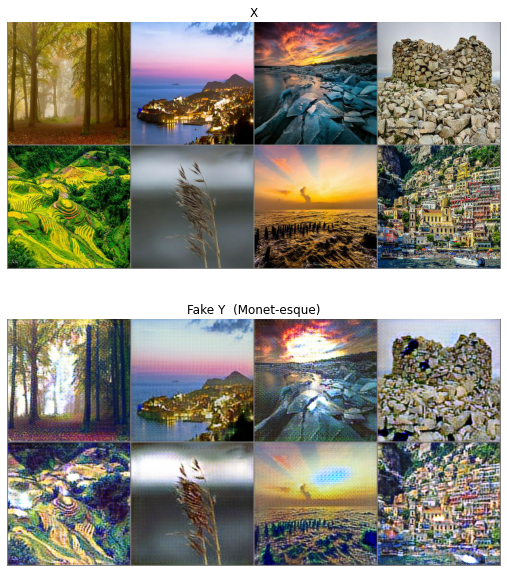

Epoch [  101/  256] | d_total_loss_avg: 0.2077 | g_total_loss: 6.9901
Epoch [  102/  256] | d_total_loss_avg: 0.1972 | g_total_loss: 7.0930
Epoch [  103/  256] | d_total_loss_avg: 0.1931 | g_total_loss: 6.9363
Epoch [  104/  256] | d_total_loss_avg: 0.1967 | g_total_loss: 6.8336
Epoch [  105/  256] | d_total_loss_avg: 0.2790 | g_total_loss: 6.9470
Epoch [  106/  256] | d_total_loss_avg: 0.1657 | g_total_loss: 6.8888
Epoch [  107/  256] | d_total_loss_avg: 0.2067 | g_total_loss: 6.5894
Epoch [  108/  256] | d_total_loss_avg: 0.1848 | g_total_loss: 6.9170
Epoch [  109/  256] | d_total_loss_avg: 0.1716 | g_total_loss: 6.8502
Epoch [  110/  256] | d_total_loss_avg: 0.1735 | g_total_loss: 6.9787


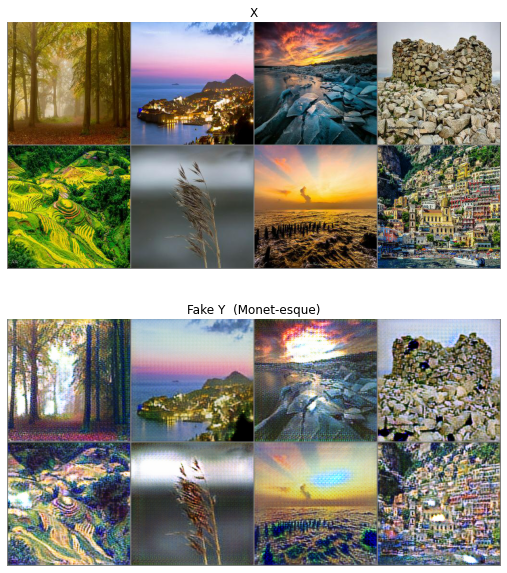

Epoch [  111/  256] | d_total_loss_avg: 0.2911 | g_total_loss: 6.7331
Epoch [  112/  256] | d_total_loss_avg: 0.1570 | g_total_loss: 6.7543
Epoch [  113/  256] | d_total_loss_avg: 0.1852 | g_total_loss: 6.8620
Epoch [  114/  256] | d_total_loss_avg: 0.1523 | g_total_loss: 6.8489
Epoch [  115/  256] | d_total_loss_avg: 0.1874 | g_total_loss: 6.6463
Epoch [  116/  256] | d_total_loss_avg: 0.1848 | g_total_loss: 6.9184
Epoch [  117/  256] | d_total_loss_avg: 0.2056 | g_total_loss: 7.0738
Epoch [  118/  256] | d_total_loss_avg: 0.1776 | g_total_loss: 6.8039
Epoch [  119/  256] | d_total_loss_avg: 0.2383 | g_total_loss: 6.7245
Epoch [  120/  256] | d_total_loss_avg: 0.1665 | g_total_loss: 6.5282


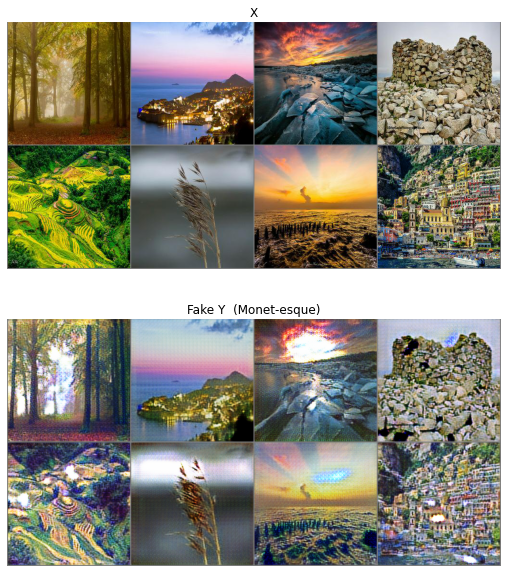

Epoch [  121/  256] | d_total_loss_avg: 0.1672 | g_total_loss: 6.9312
Epoch [  122/  256] | d_total_loss_avg: 0.1592 | g_total_loss: 6.8284
Epoch [  123/  256] | d_total_loss_avg: 0.1557 | g_total_loss: 6.8339
Epoch [  124/  256] | d_total_loss_avg: 0.1793 | g_total_loss: 6.7661
Epoch [  125/  256] | d_total_loss_avg: 0.2186 | g_total_loss: 6.9784
Epoch [  126/  256] | d_total_loss_avg: 0.1649 | g_total_loss: 6.8141
Epoch [  127/  256] | d_total_loss_avg: 0.1519 | g_total_loss: 6.8592
Epoch [  128/  256] | d_total_loss_avg: 0.1624 | g_total_loss: 6.8448
Epoch [  129/  256] | d_total_loss_avg: 0.1803 | g_total_loss: 6.9291
Epoch [  130/  256] | d_total_loss_avg: 0.1721 | g_total_loss: 6.7058


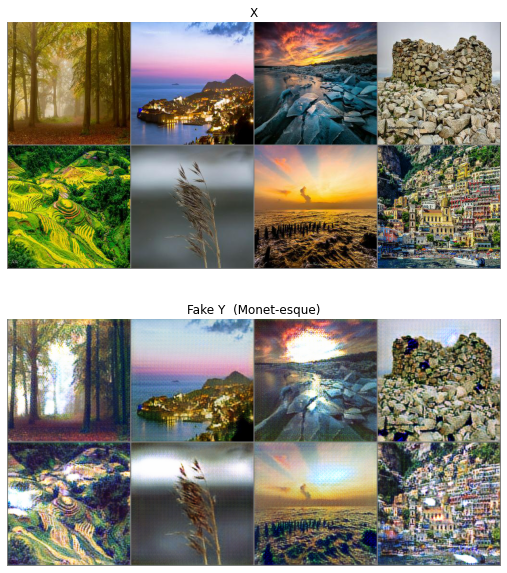

Epoch [  131/  256] | d_total_loss_avg: 0.1801 | g_total_loss: 6.7807
Epoch [  132/  256] | d_total_loss_avg: 0.1758 | g_total_loss: 6.7519
Epoch [  133/  256] | d_total_loss_avg: 0.1559 | g_total_loss: 6.8221
Epoch [  134/  256] | d_total_loss_avg: 0.1798 | g_total_loss: 6.6649
Epoch [  135/  256] | d_total_loss_avg: 0.1647 | g_total_loss: 6.8224
Epoch [  136/  256] | d_total_loss_avg: 0.1774 | g_total_loss: 6.9737
Epoch [  137/  256] | d_total_loss_avg: 0.1392 | g_total_loss: 6.6494
Epoch [  138/  256] | d_total_loss_avg: 0.1772 | g_total_loss: 6.9144
Epoch [  139/  256] | d_total_loss_avg: 0.1432 | g_total_loss: 6.7985
Epoch [  140/  256] | d_total_loss_avg: 0.1855 | g_total_loss: 6.6598


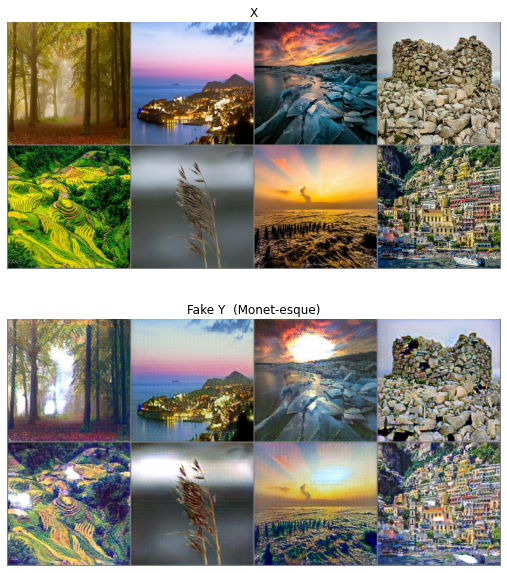

Epoch [  141/  256] | d_total_loss_avg: 0.1763 | g_total_loss: 6.7483
Epoch [  142/  256] | d_total_loss_avg: 0.1898 | g_total_loss: 6.5914
Epoch [  143/  256] | d_total_loss_avg: 0.1514 | g_total_loss: 6.7245
Epoch [  144/  256] | d_total_loss_avg: 0.1969 | g_total_loss: 6.6226
Epoch [  145/  256] | d_total_loss_avg: 0.1592 | g_total_loss: 6.7016
Epoch [  146/  256] | d_total_loss_avg: 0.1738 | g_total_loss: 6.6180
Epoch [  147/  256] | d_total_loss_avg: 0.1964 | g_total_loss: 6.5960
Epoch [  148/  256] | d_total_loss_avg: 0.1167 | g_total_loss: 6.8550
Epoch [  149/  256] | d_total_loss_avg: 0.2486 | g_total_loss: 6.6395
Epoch [  150/  256] | d_total_loss_avg: 0.1175 | g_total_loss: 6.7680


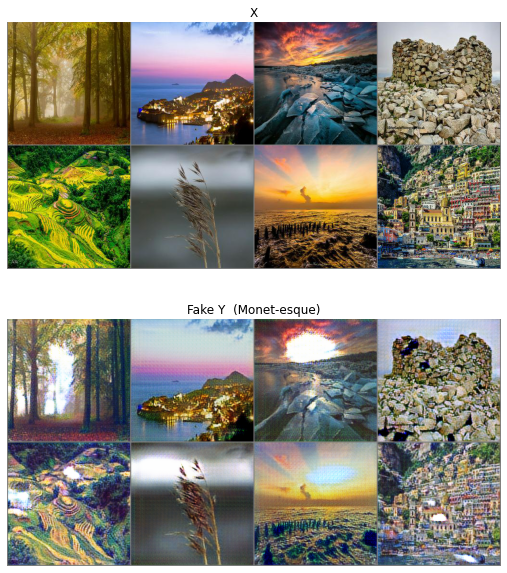

Epoch [  151/  256] | d_total_loss_avg: 0.1870 | g_total_loss: 6.7066
Epoch [  152/  256] | d_total_loss_avg: 0.1255 | g_total_loss: 6.7295
Epoch [  153/  256] | d_total_loss_avg: 0.1280 | g_total_loss: 6.7101
Epoch [  154/  256] | d_total_loss_avg: 0.1672 | g_total_loss: 6.6318
Epoch [  155/  256] | d_total_loss_avg: 0.1464 | g_total_loss: 6.7980
Epoch [  156/  256] | d_total_loss_avg: 0.1698 | g_total_loss: 6.7487
Epoch [  157/  256] | d_total_loss_avg: 0.1163 | g_total_loss: 6.7594
Epoch [  158/  256] | d_total_loss_avg: 0.1351 | g_total_loss: 6.7958
Epoch [  159/  256] | d_total_loss_avg: 0.2230 | g_total_loss: 6.6227
Epoch [  160/  256] | d_total_loss_avg: 0.1471 | g_total_loss: 6.4228


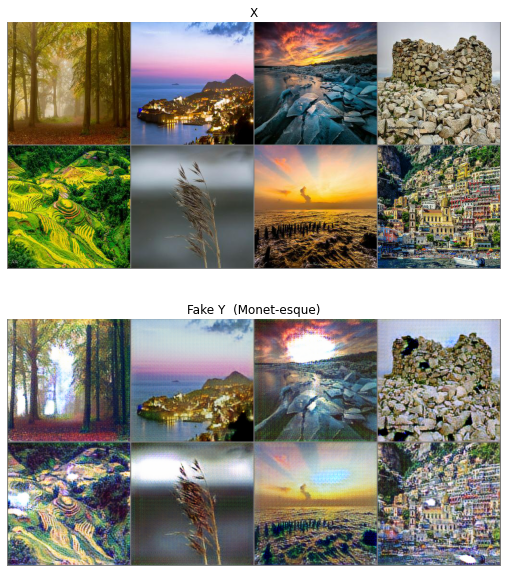

Epoch [  161/  256] | d_total_loss_avg: 0.1058 | g_total_loss: 6.5337
Epoch [  162/  256] | d_total_loss_avg: 0.1269 | g_total_loss: 6.7215
Epoch [  163/  256] | d_total_loss_avg: 0.1922 | g_total_loss: 6.4991
Epoch [  164/  256] | d_total_loss_avg: 0.1441 | g_total_loss: 6.8716
Epoch [  165/  256] | d_total_loss_avg: 0.1725 | g_total_loss: 6.7345
Epoch [  166/  256] | d_total_loss_avg: 0.1178 | g_total_loss: 6.8246
Epoch [  167/  256] | d_total_loss_avg: 0.1461 | g_total_loss: 6.6877
Epoch [  168/  256] | d_total_loss_avg: 0.1549 | g_total_loss: 6.6880
Epoch [  169/  256] | d_total_loss_avg: 0.1217 | g_total_loss: 6.7255
Epoch [  170/  256] | d_total_loss_avg: 0.1467 | g_total_loss: 7.0476


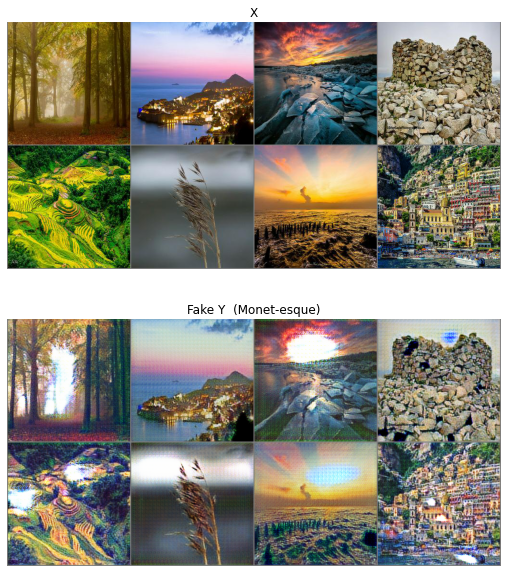

Epoch [  171/  256] | d_total_loss_avg: 0.1494 | g_total_loss: 6.7146
Epoch [  172/  256] | d_total_loss_avg: 0.1290 | g_total_loss: 6.4892
Epoch [  173/  256] | d_total_loss_avg: 0.1388 | g_total_loss: 6.5554
Epoch [  174/  256] | d_total_loss_avg: 0.1477 | g_total_loss: 6.7477
Epoch [  175/  256] | d_total_loss_avg: 0.1467 | g_total_loss: 6.6403
Epoch [  176/  256] | d_total_loss_avg: 0.1513 | g_total_loss: 6.5571
Epoch [  177/  256] | d_total_loss_avg: 0.2064 | g_total_loss: 6.6007
Epoch [  178/  256] | d_total_loss_avg: 0.1036 | g_total_loss: 6.6546
Epoch [  179/  256] | d_total_loss_avg: 0.1287 | g_total_loss: 6.6219
Epoch [  180/  256] | d_total_loss_avg: 0.1640 | g_total_loss: 6.5336


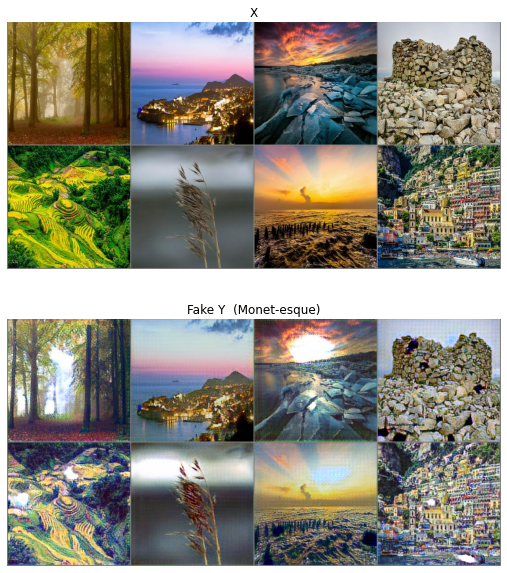

Epoch [  181/  256] | d_total_loss_avg: 0.1914 | g_total_loss: 6.4414
Epoch [  182/  256] | d_total_loss_avg: 0.1194 | g_total_loss: 6.4579
Epoch [  183/  256] | d_total_loss_avg: 0.1234 | g_total_loss: 6.6471
Epoch [  184/  256] | d_total_loss_avg: 0.1504 | g_total_loss: 6.5650
Epoch [  185/  256] | d_total_loss_avg: 0.1214 | g_total_loss: 6.4894
Epoch [  186/  256] | d_total_loss_avg: 0.1106 | g_total_loss: 6.6431
Epoch [  187/  256] | d_total_loss_avg: 0.2396 | g_total_loss: 6.5236
Epoch [  188/  256] | d_total_loss_avg: 0.1365 | g_total_loss: 6.5597
Epoch [  189/  256] | d_total_loss_avg: 0.1540 | g_total_loss: 6.5865
Epoch [  190/  256] | d_total_loss_avg: 0.1320 | g_total_loss: 6.6494


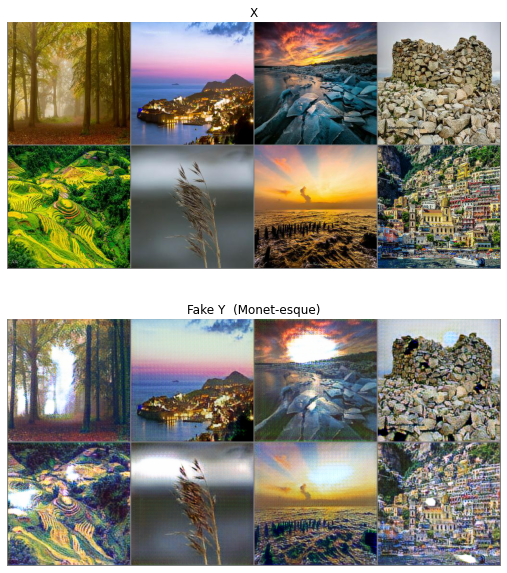

Epoch [  191/  256] | d_total_loss_avg: 0.1033 | g_total_loss: 6.6093
Epoch [  192/  256] | d_total_loss_avg: 0.1292 | g_total_loss: 6.6330
Epoch [  193/  256] | d_total_loss_avg: 0.1483 | g_total_loss: 6.4807
Epoch [  194/  256] | d_total_loss_avg: 0.1191 | g_total_loss: 6.5863
Epoch [  195/  256] | d_total_loss_avg: 0.1563 | g_total_loss: 6.5655
Epoch [  196/  256] | d_total_loss_avg: 0.1076 | g_total_loss: 6.6352
Epoch [  197/  256] | d_total_loss_avg: 0.1169 | g_total_loss: 6.6516
Epoch [  198/  256] | d_total_loss_avg: 0.1782 | g_total_loss: 6.5243
Epoch [  199/  256] | d_total_loss_avg: 0.1124 | g_total_loss: 6.6560
Epoch [  200/  256] | d_total_loss_avg: 0.1646 | g_total_loss: 6.7000


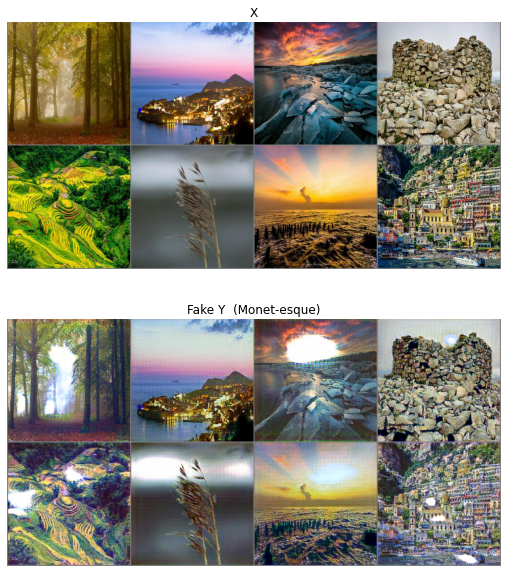

Epoch [  201/  256] | d_total_loss_avg: 0.1168 | g_total_loss: 6.4718
Epoch [  202/  256] | d_total_loss_avg: 0.1434 | g_total_loss: 6.5424
Epoch [  203/  256] | d_total_loss_avg: 0.1340 | g_total_loss: 6.2836
Epoch [  204/  256] | d_total_loss_avg: 0.1372 | g_total_loss: 6.5681
Epoch [  205/  256] | d_total_loss_avg: 0.1636 | g_total_loss: 6.3606
Epoch [  206/  256] | d_total_loss_avg: 0.1172 | g_total_loss: 6.6035
Epoch [  207/  256] | d_total_loss_avg: 0.1133 | g_total_loss: 6.3648
Epoch [  208/  256] | d_total_loss_avg: 0.1695 | g_total_loss: 6.5196
Epoch [  209/  256] | d_total_loss_avg: 0.0969 | g_total_loss: 6.7754
Epoch [  210/  256] | d_total_loss_avg: 0.1411 | g_total_loss: 6.6562


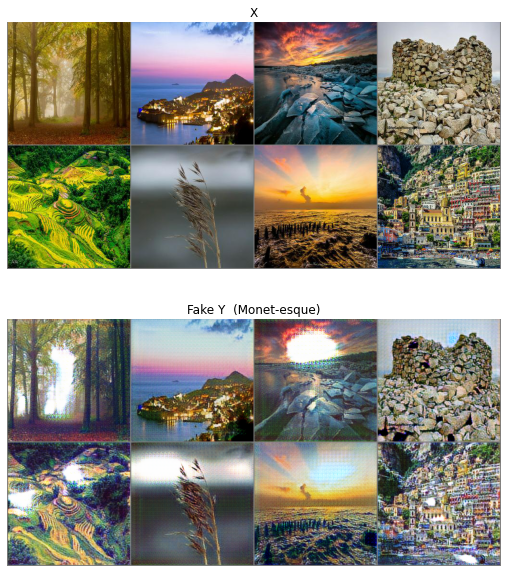

Epoch [  211/  256] | d_total_loss_avg: 0.1122 | g_total_loss: 6.5883
Epoch [  212/  256] | d_total_loss_avg: 0.1624 | g_total_loss: 6.7103
Epoch [  213/  256] | d_total_loss_avg: 0.0958 | g_total_loss: 6.4620
Epoch [  214/  256] | d_total_loss_avg: 0.0989 | g_total_loss: 6.4703
Epoch [  215/  256] | d_total_loss_avg: 0.1058 | g_total_loss: 6.5523
Epoch [  216/  256] | d_total_loss_avg: 0.1659 | g_total_loss: 6.4633
Epoch [  217/  256] | d_total_loss_avg: 0.1534 | g_total_loss: 6.5877
Epoch [  218/  256] | d_total_loss_avg: 0.1065 | g_total_loss: 6.5490
Epoch [  219/  256] | d_total_loss_avg: 0.0956 | g_total_loss: 6.3601
Epoch [  220/  256] | d_total_loss_avg: 0.1266 | g_total_loss: 6.4439


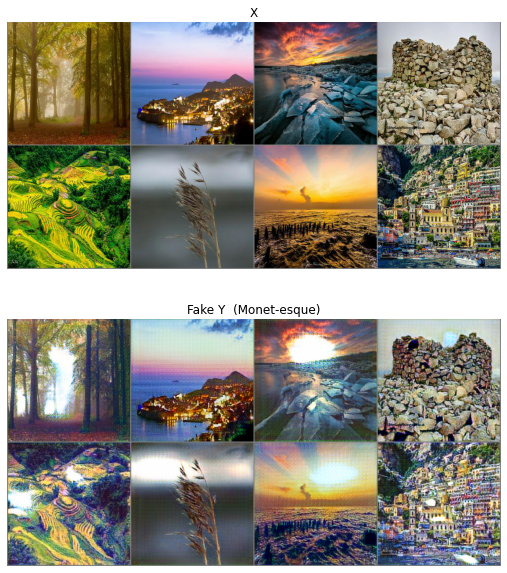

Epoch [  221/  256] | d_total_loss_avg: 0.2149 | g_total_loss: 6.4700
Epoch [  222/  256] | d_total_loss_avg: 0.1023 | g_total_loss: 6.4191
Epoch [  223/  256] | d_total_loss_avg: 0.0795 | g_total_loss: 6.4497
Epoch [  224/  256] | d_total_loss_avg: 0.1217 | g_total_loss: 6.4737
Epoch [  225/  256] | d_total_loss_avg: 0.1059 | g_total_loss: 6.4418
Epoch [  226/  256] | d_total_loss_avg: 0.1084 | g_total_loss: 6.4554
Epoch [  227/  256] | d_total_loss_avg: 0.1293 | g_total_loss: 6.5167
Epoch [  228/  256] | d_total_loss_avg: 0.1286 | g_total_loss: 6.4714
Epoch [  229/  256] | d_total_loss_avg: 0.0966 | g_total_loss: 6.6921
Epoch [  230/  256] | d_total_loss_avg: 0.1231 | g_total_loss: 6.4257


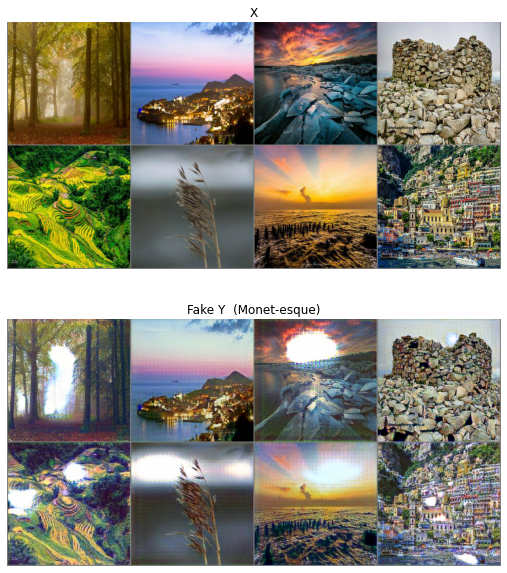

Epoch [  231/  256] | d_total_loss_avg: 0.1504 | g_total_loss: 6.5076
Epoch [  232/  256] | d_total_loss_avg: 0.0963 | g_total_loss: 6.5041
Epoch [  233/  256] | d_total_loss_avg: 0.1240 | g_total_loss: 6.4786
Epoch [  234/  256] | d_total_loss_avg: 0.1226 | g_total_loss: 6.6936
Epoch [  235/  256] | d_total_loss_avg: 0.1164 | g_total_loss: 6.5542
Epoch [  236/  256] | d_total_loss_avg: 0.1404 | g_total_loss: 6.3725
Epoch [  237/  256] | d_total_loss_avg: 0.1159 | g_total_loss: 6.3912
Epoch [  238/  256] | d_total_loss_avg: 0.1428 | g_total_loss: 6.5340
Epoch [  239/  256] | d_total_loss_avg: 0.1187 | g_total_loss: 6.3462
Epoch [  240/  256] | d_total_loss_avg: 0.0972 | g_total_loss: 6.4361


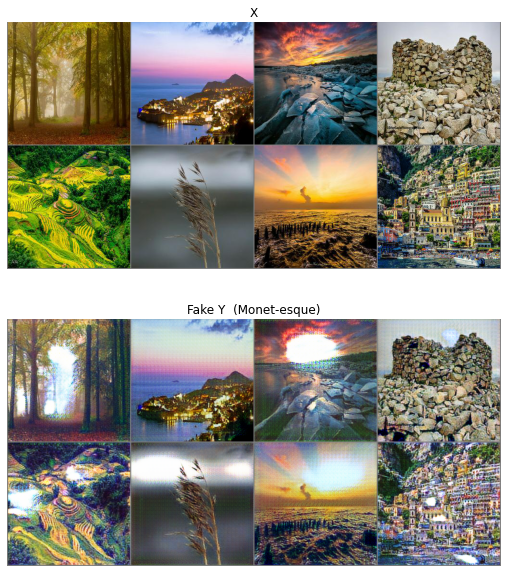

Epoch [  241/  256] | d_total_loss_avg: 0.1356 | g_total_loss: 6.4357
Epoch [  242/  256] | d_total_loss_avg: 0.0984 | g_total_loss: 6.3520
Epoch [  243/  256] | d_total_loss_avg: 0.1549 | g_total_loss: 6.4403
Epoch [  244/  256] | d_total_loss_avg: 0.1577 | g_total_loss: 6.3887
Epoch [  245/  256] | d_total_loss_avg: 0.1066 | g_total_loss: 6.4668
Epoch [  246/  256] | d_total_loss_avg: 0.1269 | g_total_loss: 6.4075
Epoch [  247/  256] | d_total_loss_avg: 0.1735 | g_total_loss: 6.3215
Epoch [  248/  256] | d_total_loss_avg: 0.0981 | g_total_loss: 6.3772
Epoch [  249/  256] | d_total_loss_avg: 0.1333 | g_total_loss: 6.2539
Epoch [  250/  256] | d_total_loss_avg: 0.0960 | g_total_loss: 6.3262


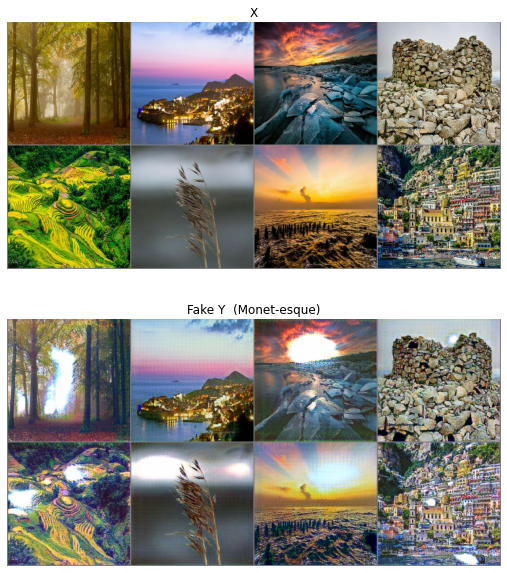

Epoch [  251/  256] | d_total_loss_avg: 0.1023 | g_total_loss: 6.4187
Epoch [  252/  256] | d_total_loss_avg: 0.1854 | g_total_loss: 6.4572
Epoch [  253/  256] | d_total_loss_avg: 0.0915 | g_total_loss: 6.2977
Epoch [  254/  256] | d_total_loss_avg: 0.0924 | g_total_loss: 6.4118
Epoch [  255/  256] | d_total_loss_avg: 0.1260 | g_total_loss: 6.3715
Epoch [  256/  256] | d_total_loss_avg: 0.1361 | g_total_loss: 6.3697


In [28]:
n_epochs = epoch_true * batches_per_epoch
losses = training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y, n_epochs=n_epochs)

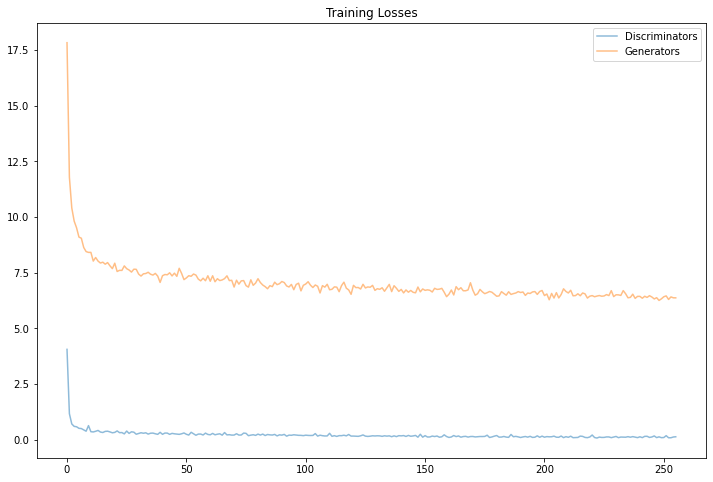

In [29]:
#Plot loss functions over training
fig, ax = plt.subplots(figsize=(12,8))
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminators', alpha=0.5)
plt.plot(losses.T[1], label='Generators', alpha=0.5)
plt.title("Training Losses")
plt.legend()
plt.show()

In [30]:
#Get some fixed data from domains X and Y for sampling. These are images that are held constant throughout training, that allow us to inspect the model's performance.
test_iter_X = iter(test_dataloader_X)
test_iter_Y = iter(test_dataloader_Y)

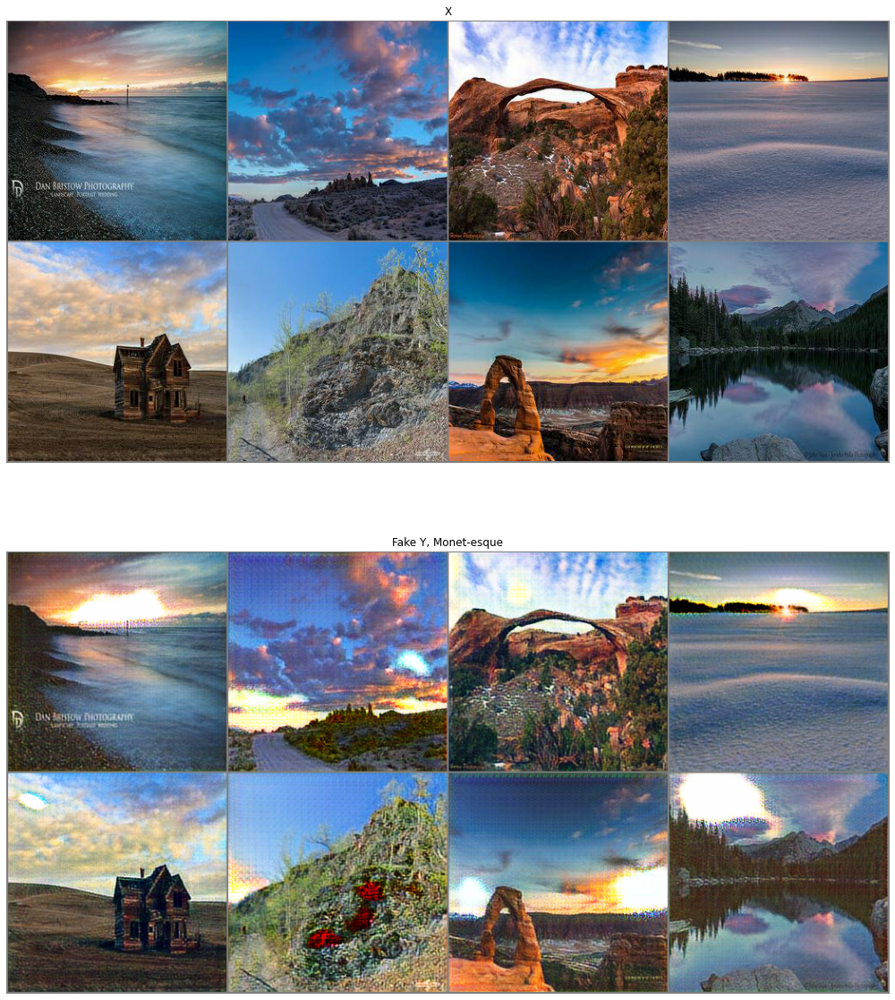

In [31]:
#Sample
fixed_X = test_iter_X.next()
fixed_X = test_iter_X.next()
fixed_X = test_iter_X.next()

#Evaluation
G_XtoY.eval()

mean_=0.5
std_=0.5

#Identify correct device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
#Create fake pictures for both cycles
fake_Y = G_XtoY(fixed_X.to(device))
    
#Generate grids
grid_x =  make_grid(fixed_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
grid_fake_y =  make_grid(fake_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy() 
    
#Normalize pictures to pixel range rom 0 to 255
X, fake_Y_ = reverse_normalize(grid_x, mean_, std_), reverse_normalize(grid_fake_y, mean_, std_)

#Transformation from X -> Y
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(30, 20))
ax1.imshow(X)
ax1.axis('off')
ax1.set_title('X')
ax2.imshow(fake_Y_)
ax2.axis('off')
ax2.set_title('Fake Y, Monet-esque')
plt.show()

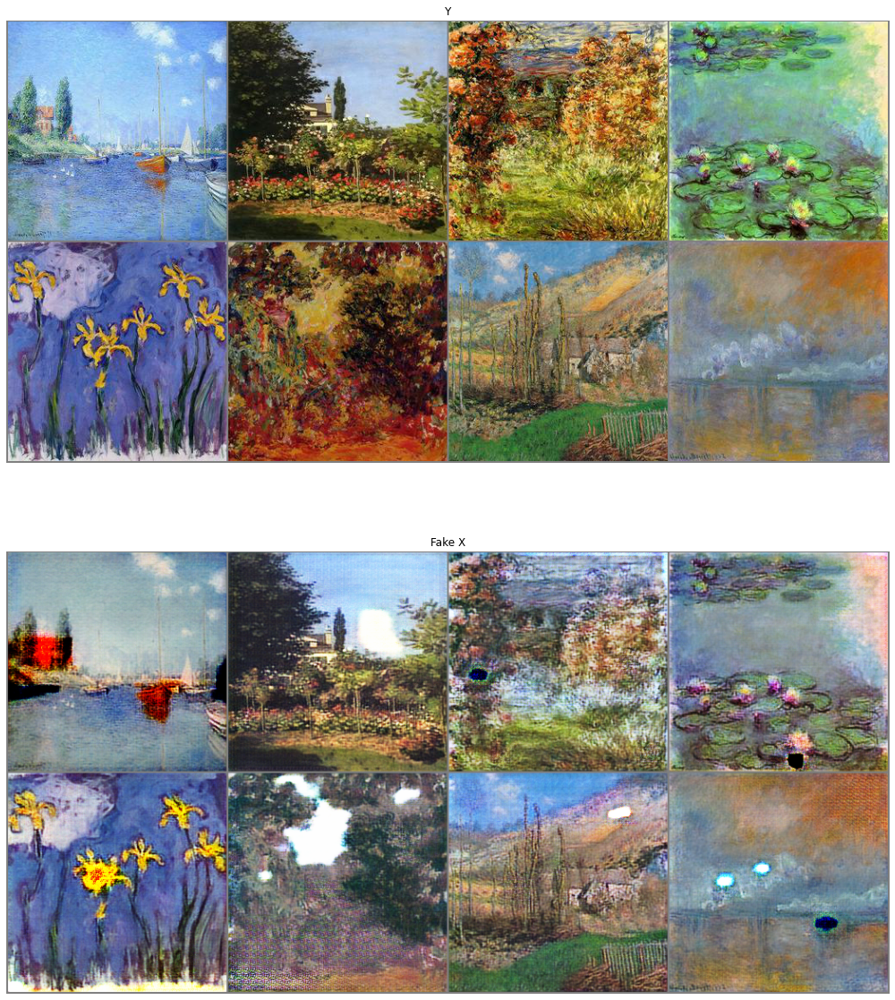

In [32]:
#Sample
fixed_Y = test_iter_Y.next()
fixed_Y = test_iter_Y.next()
fixed_Y = test_iter_Y.next()

#Evaluation
G_YtoX.eval()

mean_=0.5
std_=0.5

#Identify correct device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
#Create fake pictures for both cycles
fake_X = G_YtoX(fixed_Y.to(device))
    
#Generate grids
grid_y =  make_grid(fixed_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
grid_fake_x =  make_grid(fake_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()  
    
#Normalize pictures to pixel range rom 0 to 255
Y, fake_X_ = reverse_normalize(grid_y, mean_, std_), reverse_normalize(grid_fake_x, mean_, std_)

#Transformation from Y -> X
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(30, 20))
ax1.imshow(Y)
ax1.axis('off')
ax1.set_title('Y')
ax2.imshow(fake_X_)
ax2.axis('off')
ax2.set_title('Fake X')
plt.show()